In [35]:
import numpy as np
import matplotlib
from matplotlib import pylab
%config InlineBackend.figure_format = 'retina'
matplotlib.rcParams['figure.dpi'] = 80
textsize = 'x-large'
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (6, 4),
         'axes.labelsize': textsize,
         'axes.titlesize': textsize,
         'xtick.labelsize': textsize,
         'ytick.labelsize': textsize,
         'figure.facecolor': 'w'}
pylab.rcParams.update(params)
from matplotlib import pyplot as plt
import os

import h5py
import corner

%load_ext autoreload
%autoreload 2
import plotter
import emulator

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


All params: ['Omega_m', 'Omega_b', 'sigma_8', 'h', 'n_s', 'N_eff', 'w', 'M_sat', 'alpha', 'M_cut', 'sigma_logM', 'v_bc', 'v_bs', 'c_vir', 'f', 'f_env', 'delta_env', 'sigma_env']

In [2]:
cosmo, hod = 3, 3
statistic = 'wp'
traintag = '_nonolap'
testtag = '_mean_test0'
errtag = '_100hod_test0'
kernel_name = 'M32ExpConst2'
nhod = 100
tag = '_log_kM32ExpConst2_{}hod'.format(nhod)

gptag = traintag + errtag + tag
res_dir = '../../clust/results_{}/'.format(statistic)
gperr = np.loadtxt(res_dir+"{}_error{}.dat".format(statistic, errtag))
training_dir = '{}training_{}{}/'.format(res_dir, statistic, traintag)
testing_dir = '{}testing_{}{}/'.format(res_dir, statistic, testtag)
hyperparams = "../training_results/{}_training_results{}.dat".format(statistic, gptag)

emu = emulator.Emulator(statistic, training_dir, gperr=gperr, hyperparams=hyperparams, nhod=nhod, kernel_name=kernel_name)
emu.build()

george version: 0.3.1
Loading training data
Nparams: 18
Rebuilding emulators


In [52]:
def check_chains(chaintag): 
    chain_fn = f'../chains/chains_{chaintag}.h5'
    if os.path.exists(chain_fn):
        fw = h5py.File(chain_fn, 'r')
        chain_dset = fw['chain']
        print(f"{chaintag}: {chain_dset}")
    else:
        print(f"chain {chain_fn} doesn't exist!")

In [3]:
def plot_chains(chaintag, show_walkers=False, show_corner=True, show_params=None): 
    #chaintag = 'wp_c3h3_Msat_fenv_xlong_diag'
    chain_fn = f'../chains/chains_{chaintag}.h5'
    fw = h5py.File(chain_fn, 'r')

    chain_dset = fw['chain']
    print(chain_dset)
    chain = np.array(chain_dset)
    lnprob_dset = fw['lnprob']
    param_names = fw.attrs['param_names']
    true_values = fw.attrs['true_values']
    nwalkers, nchain, ndim = chain_dset.shape

    if show_params:    
        idxs = []
        for sp in show_params:
            idxs.append(np.where(param_names == sp))
        idxs = np.array(idxs).flatten()
        chain = chain[:,:,idxs]
        param_names = show_params
        true_values = true_values[idxs]

    if show_walkers:
        for k in range(ndim):
            plt.figure()
            pname = param_names[k]
            for j in range(nwalkers):
                plt.title(pname)
                plt.plot(chain[j,:,k], alpha=1)
                low, high = emu.get_param_bounds(pname)
                plt.axhline(low, ls=':', color='k')
                plt.axhline(high, ls=':', color='k')
                plt.axhline(true_values[k], ls='-', lw=2, color='k')
        plt.xlabel('step')

        plt.figure()
        for j in range(nwalkers):
            plt.plot(lnprob_dset[j,:], alpha=1)
        plt.ylabel('lnprob')
        plt.xlabel('step')

    if show_corner:
        fig = corner.corner(chain.reshape(-1, chain.shape[-1]), labels=param_names, truths=true_values)

<HDF5 dataset "chain": shape (24, 4300, 2), type "<f4">


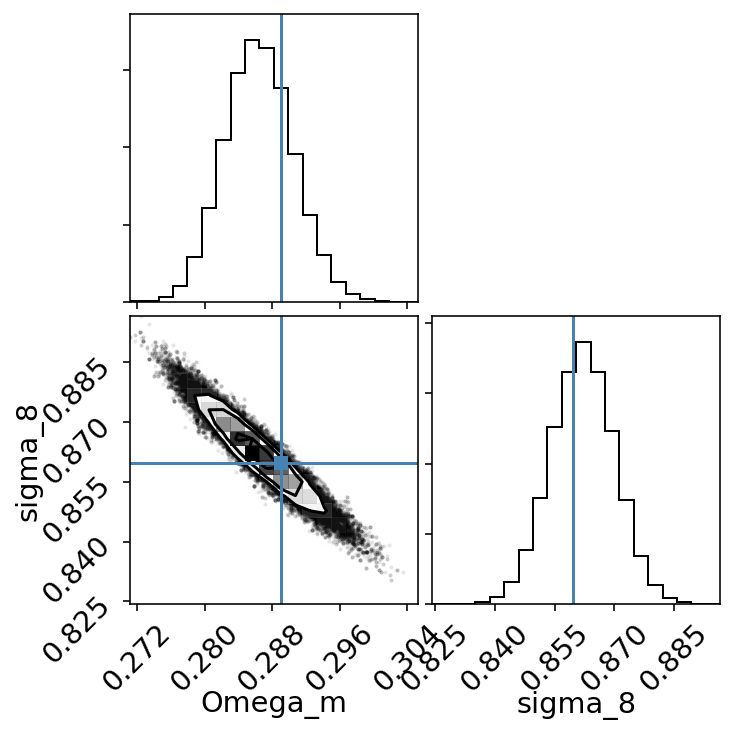

In [4]:
plot_chains('wp_upf_c3h3_omegam_sigma8_test')

<HDF5 dataset "chain": shape (24, 3000, 2), type "<f4">


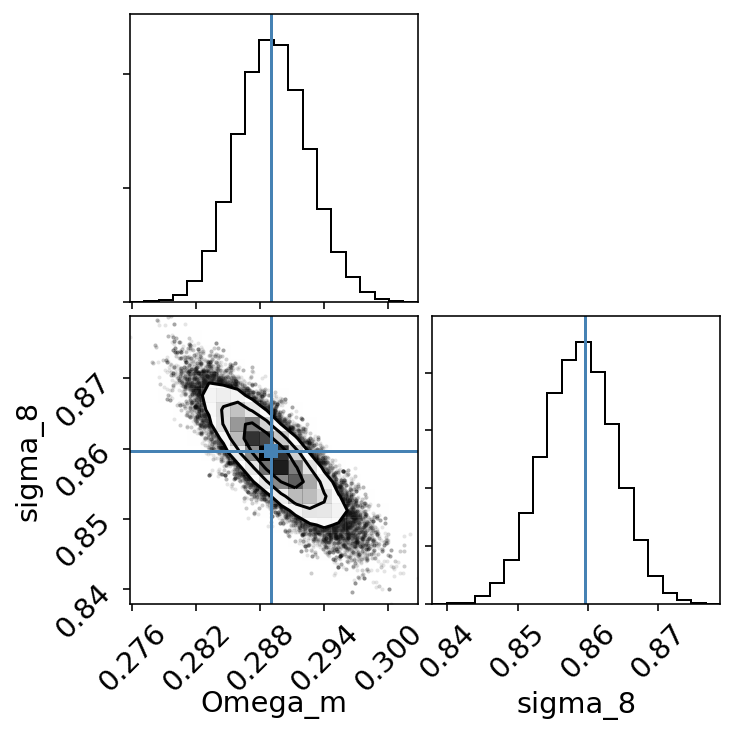

In [5]:
plot_chains('wp_upf_c3h3_omegam_sigma8_covperf')

<HDF5 dataset "chain": shape (96, 9200, 7), type "<f4">


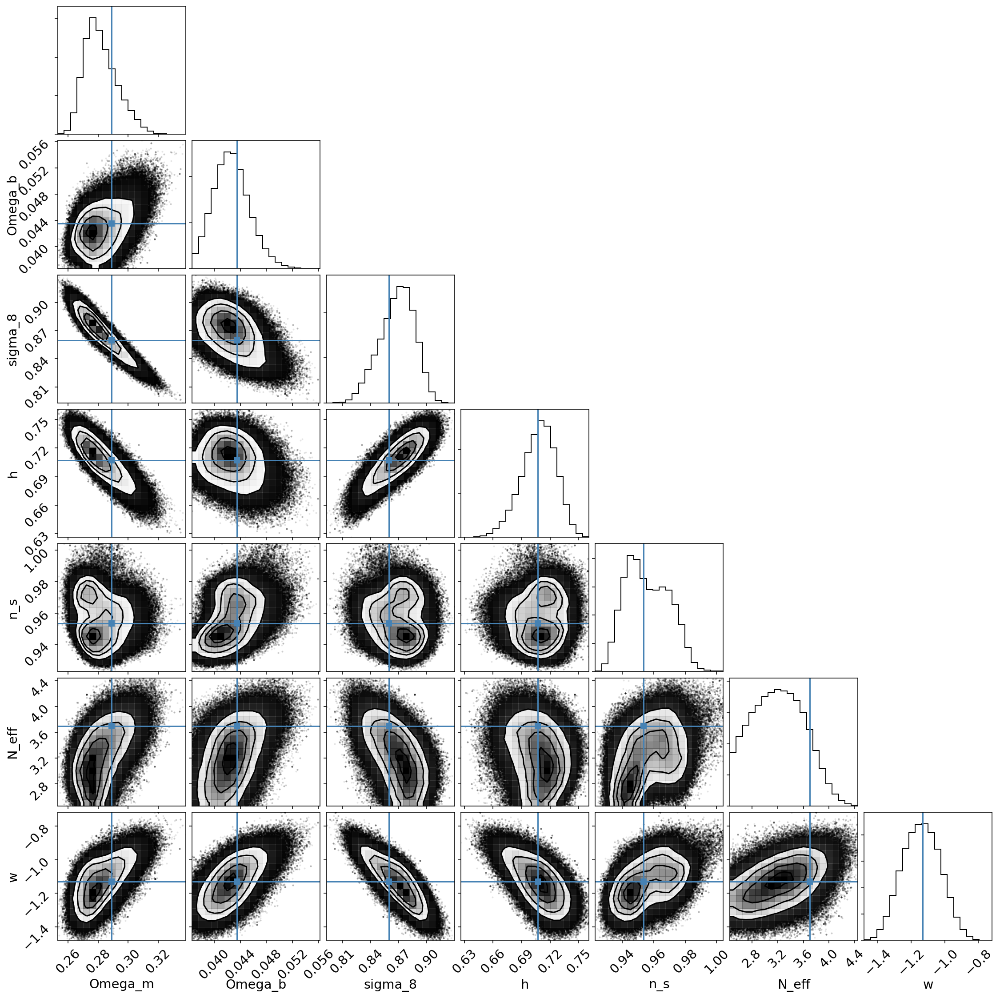

In [6]:
plot_chains('wp_upf_c3h3_allcosmo_covperf')

<HDF5 dataset "chain": shape (96, 6400, 5), type "<f4">


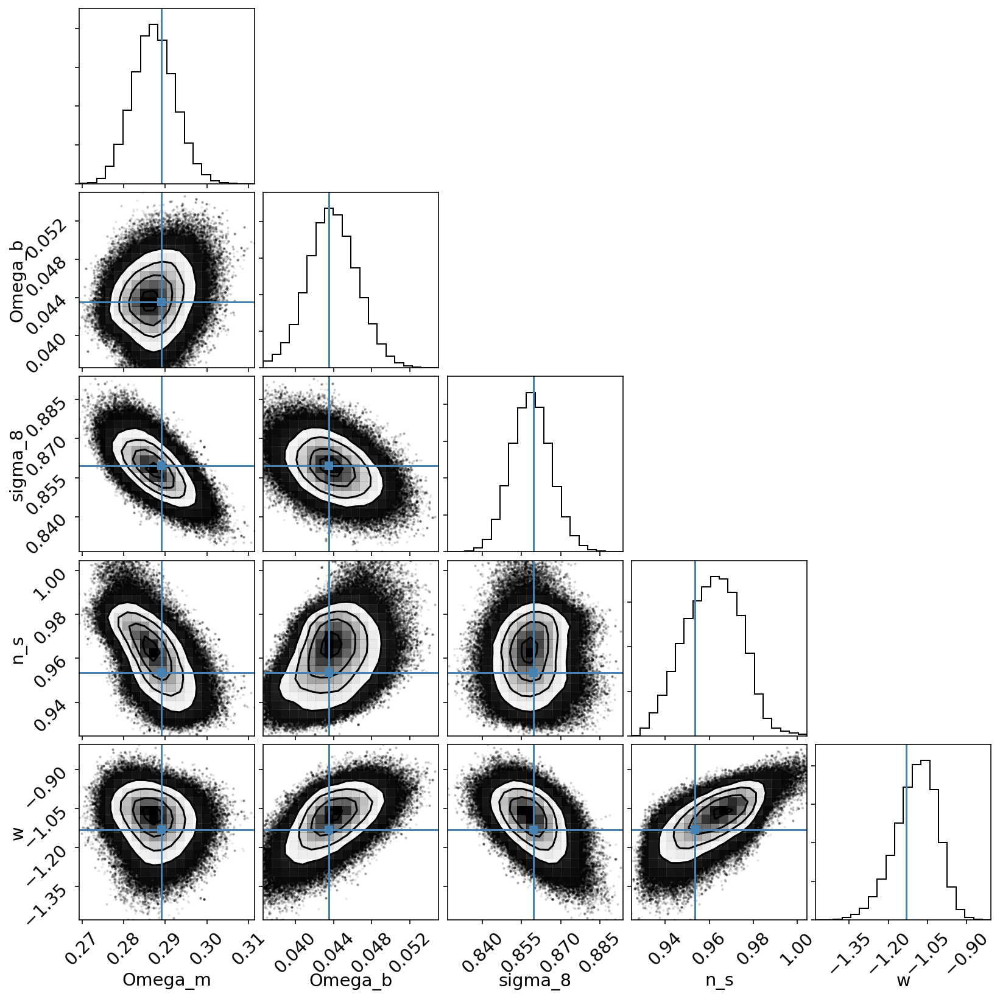

In [7]:
# SHOULD BE COVPERF, CHANGE NAME WHEN DONE RUNNING
plot_chains('wp_upf_c3h3_5cosmo_covfrac')

<HDF5 dataset "chain": shape (96, 9700, 11), type "<f4">


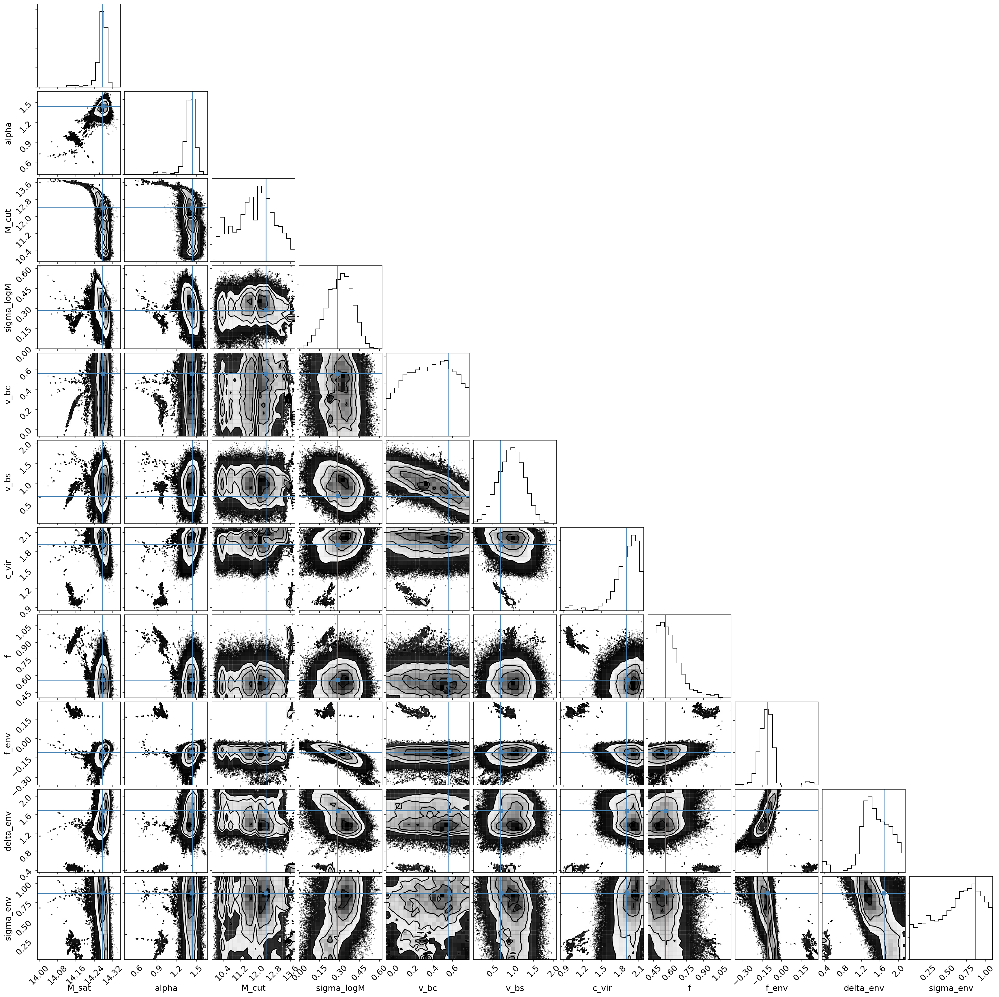

In [8]:
plot_chains('wp_upf_c3h3_allhod_covperf')

<HDF5 dataset "chain": shape (96, 10800, 18), type "<f4">


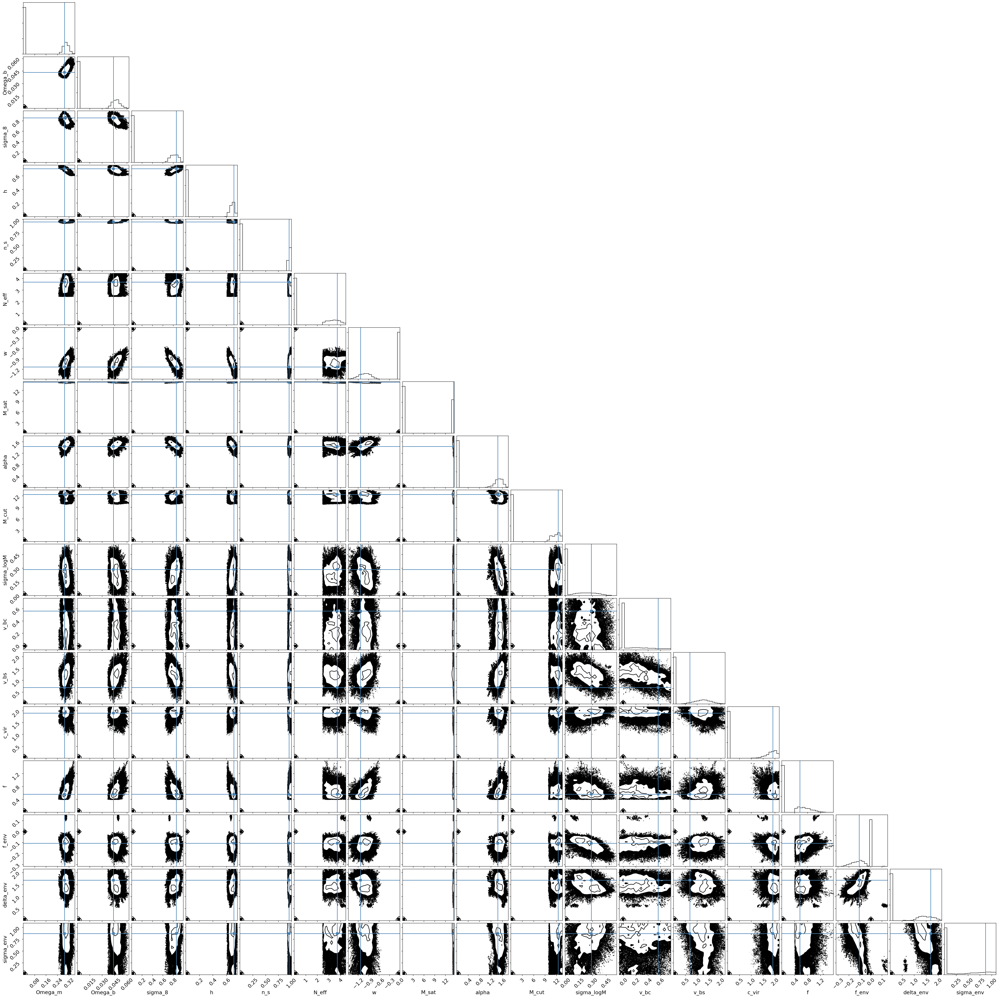

In [9]:
plot_chains('wp_upf_c3h3_all_covperf')

<HDF5 dataset "chain": shape (96, 10800, 18), type "<f4">


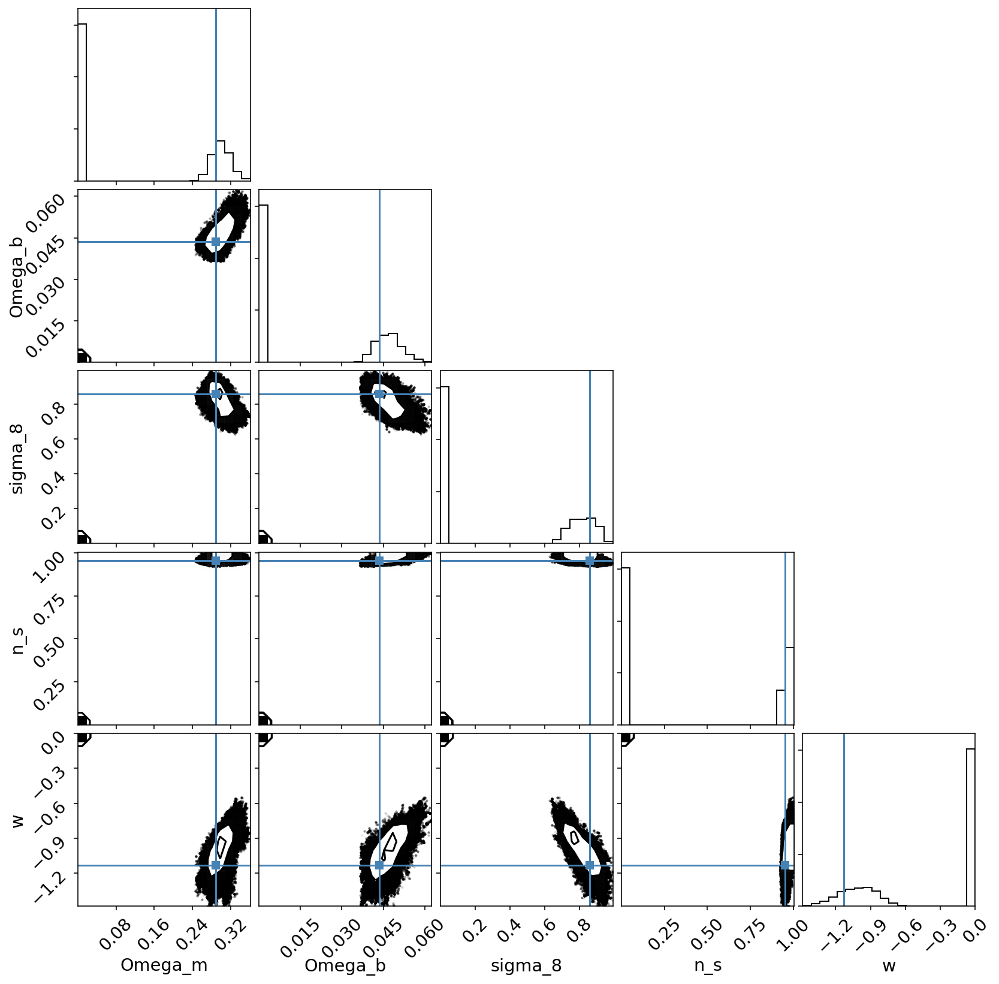

In [10]:
plot_chains('wp_upf_c3h3_all_covperf', show_params=['Omega_m', 'Omega_b', 'sigma_8', 'n_s', 'w'])

<HDF5 dataset "chain": shape (96, 10800, 18), type "<f4">


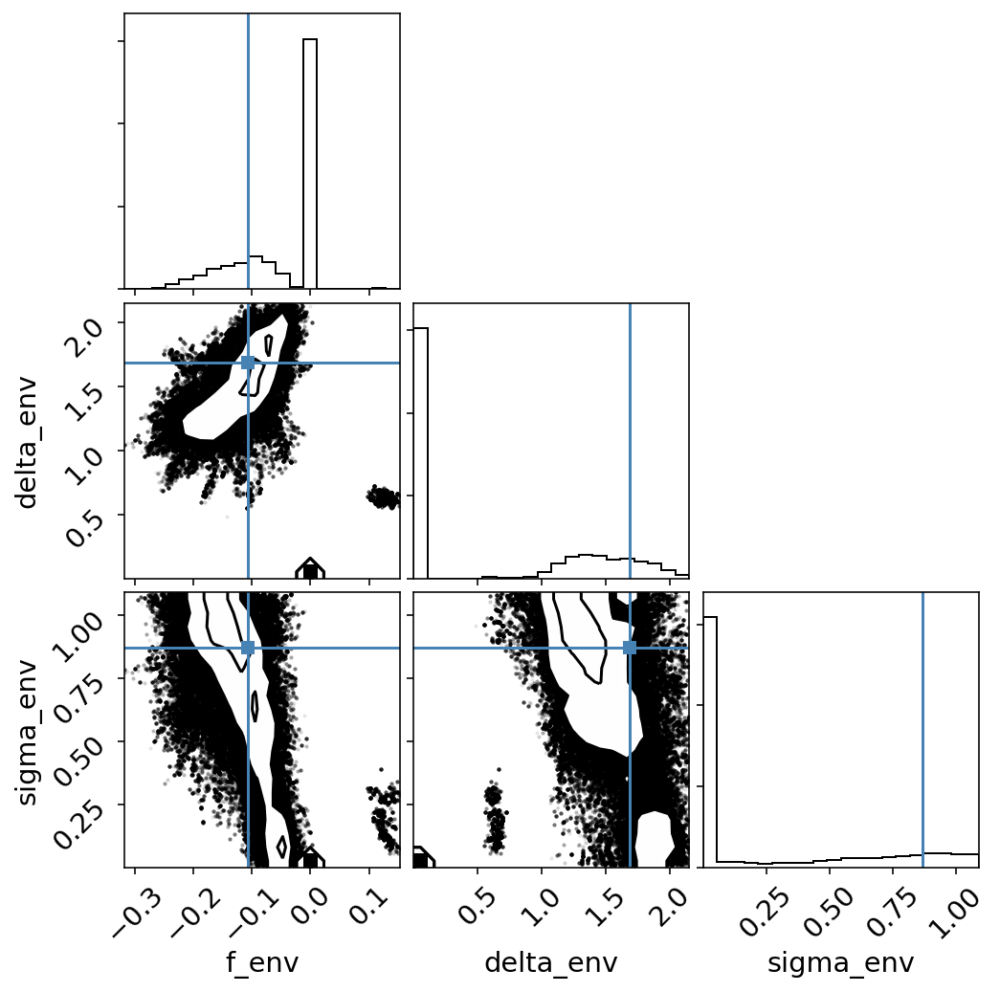

In [11]:
plot_chains('wp_upf_c3h3_all_covperf', show_params=['f_env', 'delta_env', 'sigma_env'])

<HDF5 dataset "chain": shape (96, 29200, 18), type "<f4">


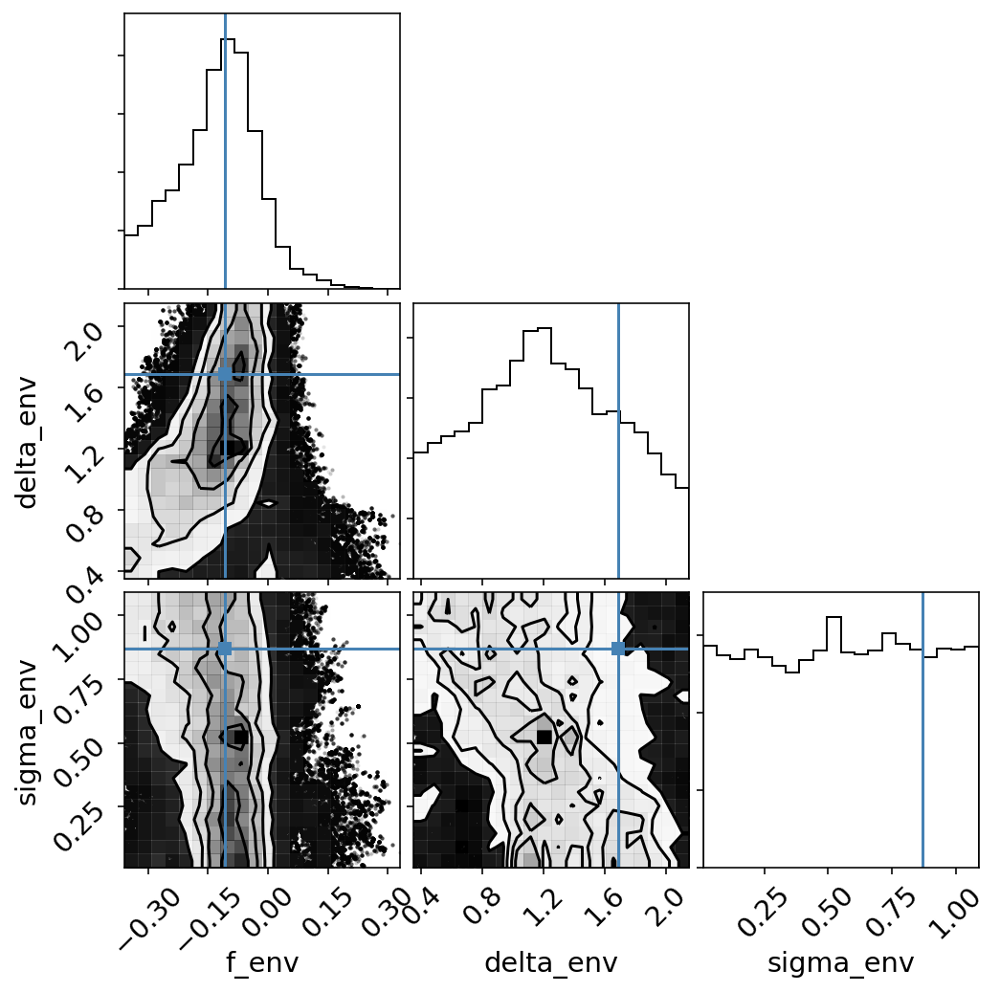

In [12]:
plot_chains('wp_c3h3_all_covfrac', show_params=['f_env', 'delta_env', 'sigma_env'])

<HDF5 dataset "chain": shape (24, 20000, 11), type "<f4">


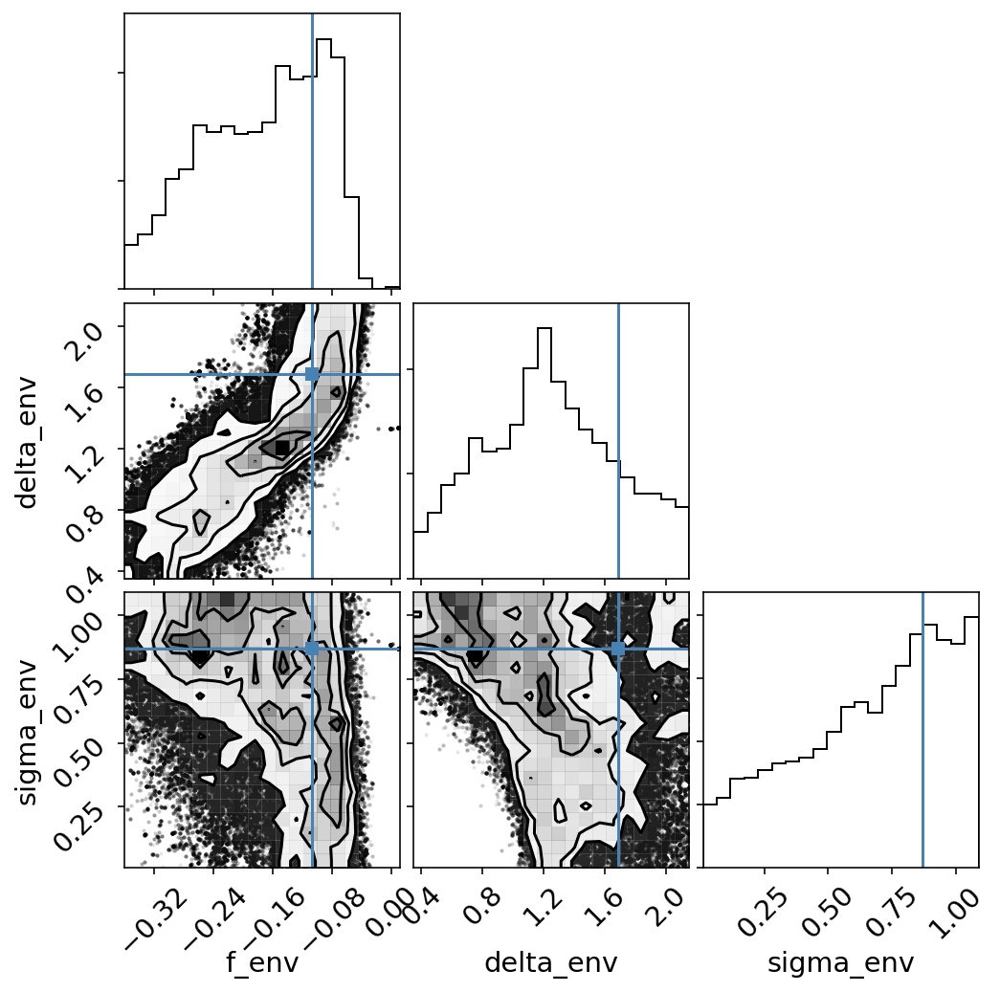

In [21]:
plot_chains('wp_c3h3_allhod_covfrac', show_params=['f_env', 'delta_env', 'sigma_env'])

<HDF5 dataset "chain": shape (96, 9800, 11), type "<f4">


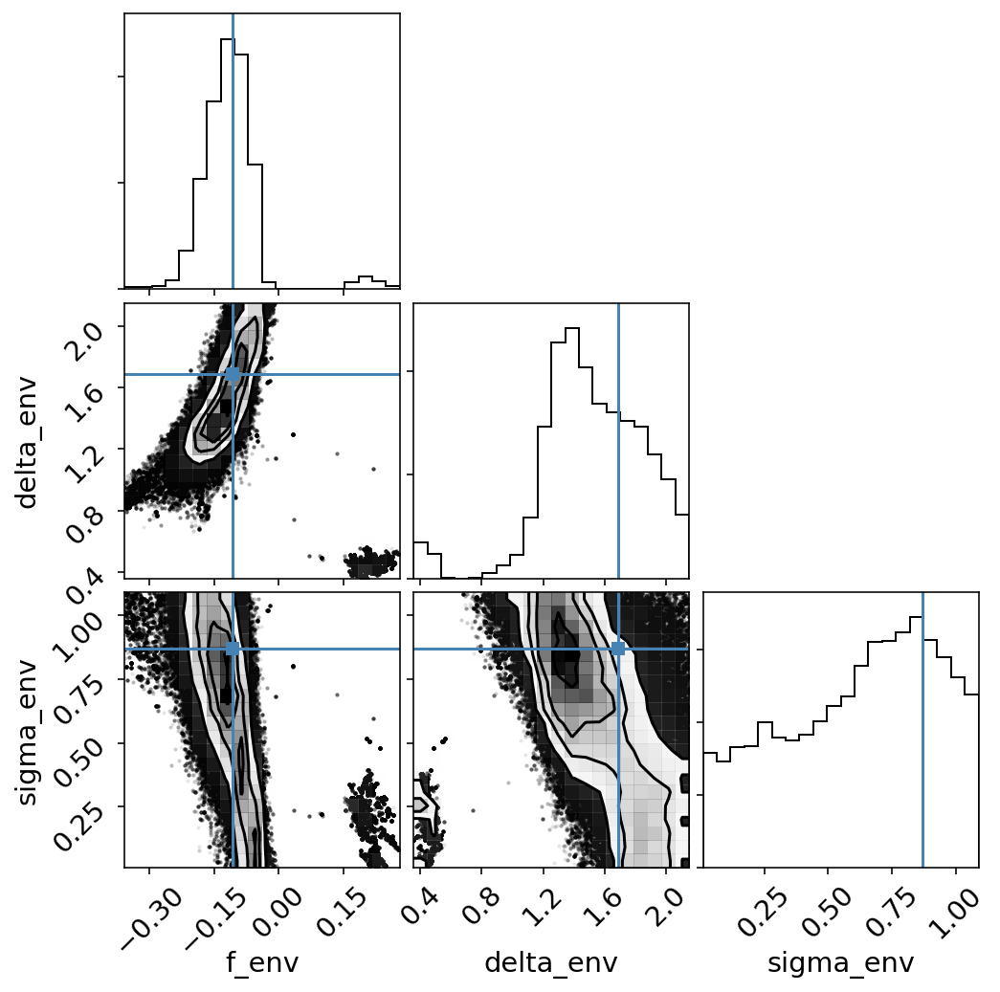

In [13]:
plot_chains('wp_upf_c3h3_allhod_covperf', show_params=['f_env', 'delta_env', 'sigma_env'])

In [22]:
plot_chains('wp_upf_c3h3_allhod_covperf', show_params=['f_env', 'delta_env', 'sigma_env'])

<HDF5 dataset "chain": shape (0, 0, 11), type "<f4">


AssertionError: I don't believe that you want more dimensions than samples!

<HDF5 dataset "chain": shape (24, 20000, 11), type "<f4">


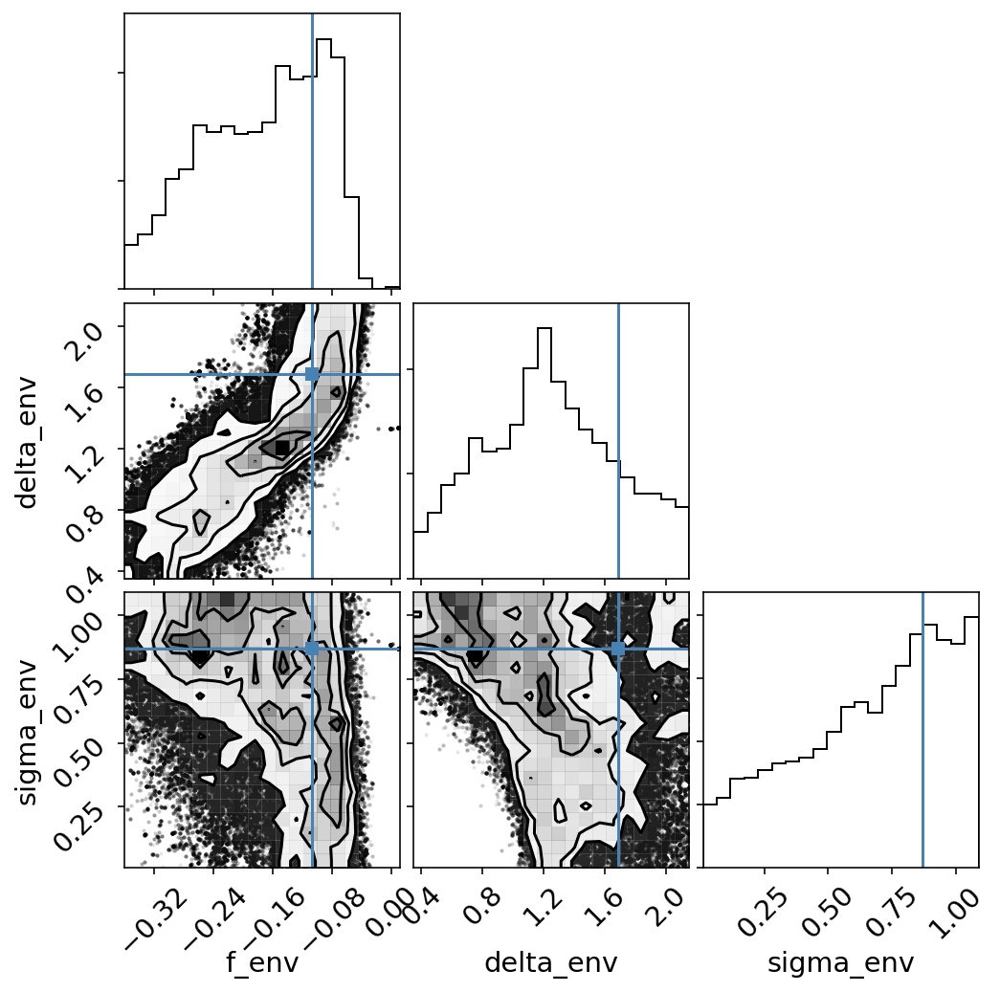

In [17]:
plot_chains('wp_c3h3_allhod_covfrac', show_params=['f_env', 'delta_env', 'sigma_env'])

<HDF5 dataset "chain": shape (96, 10800, 18), type "<f4">


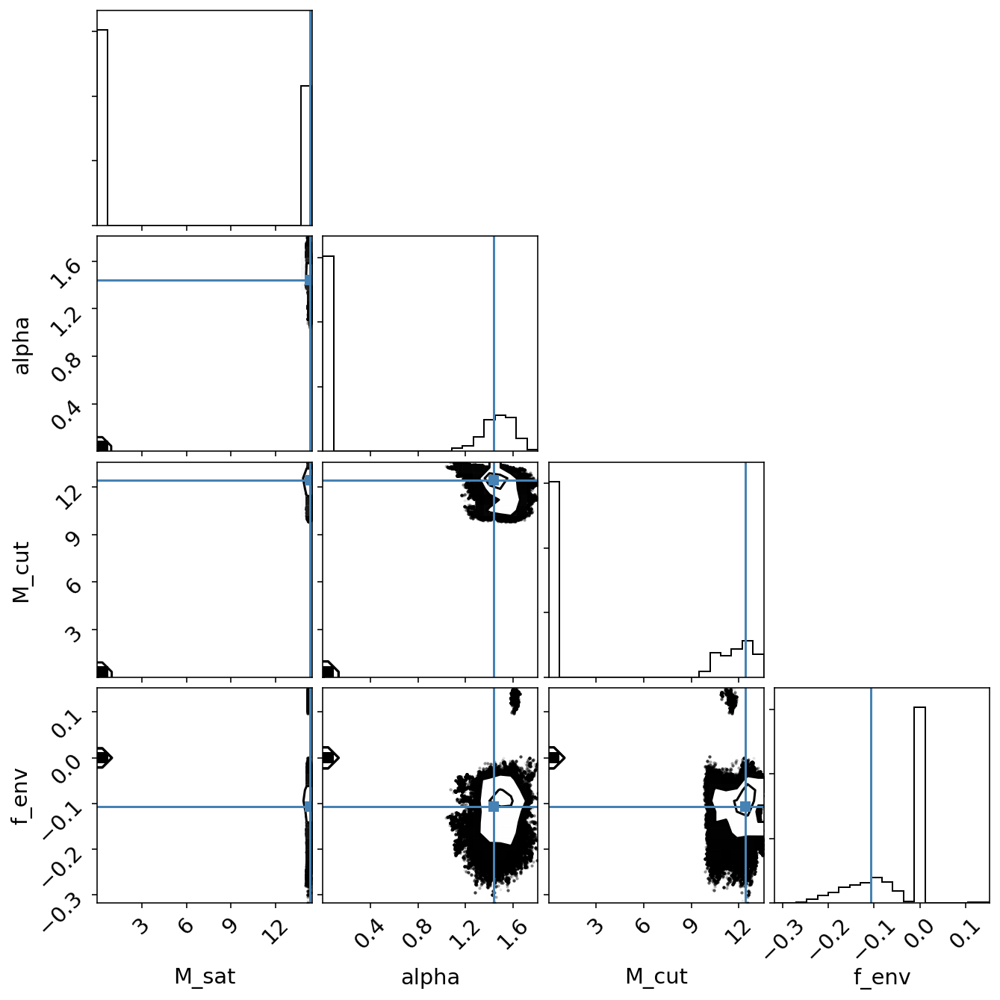

In [14]:
plot_chains('wp_upf_c3h3_all_covperf', show_params=['M_sat', 'alpha', 'M_cut', 'f_env'])

<HDF5 dataset "chain": shape (96, 9800, 11), type "<f4">


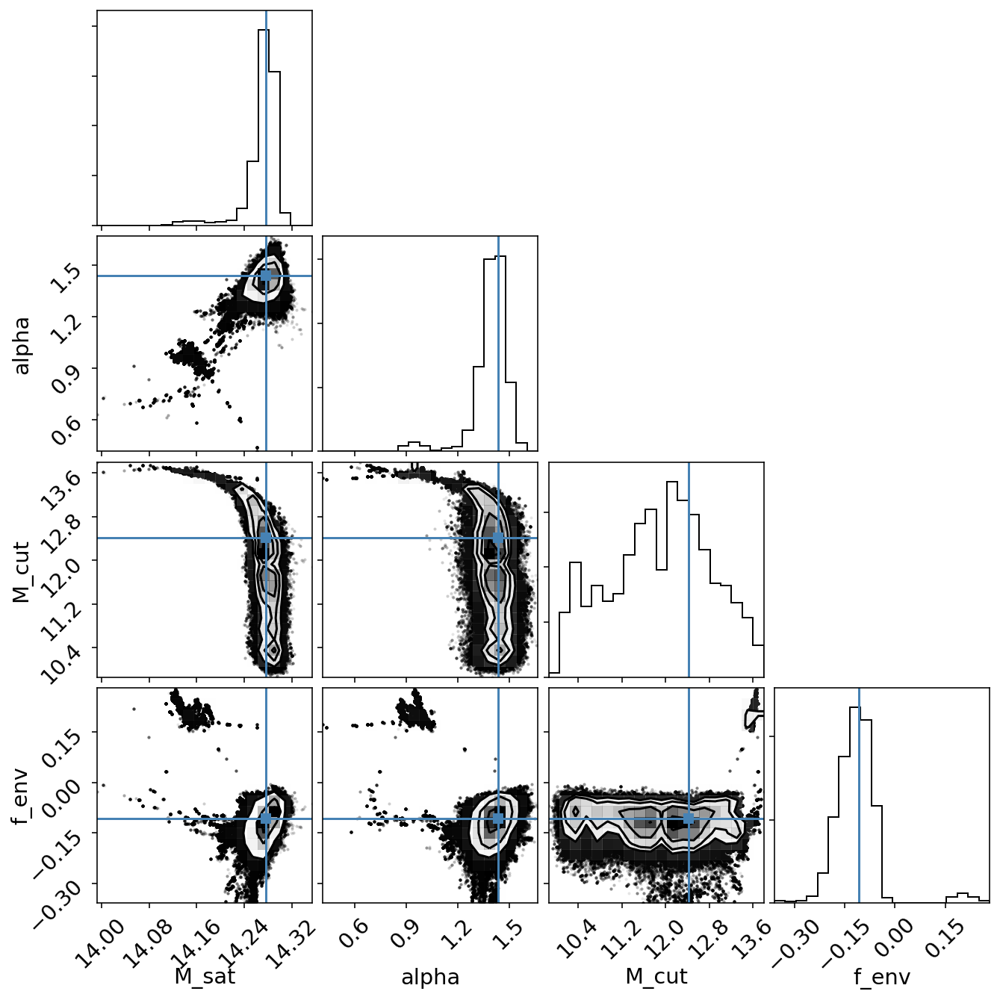

In [15]:
plot_chains('wp_upf_c3h3_allhod_covperf', show_params=['M_sat', 'alpha', 'M_cut', 'f_env'])

<HDF5 dataset "chain": shape (96, 10900, 18), type "<f4">


IndexError: list index out of range

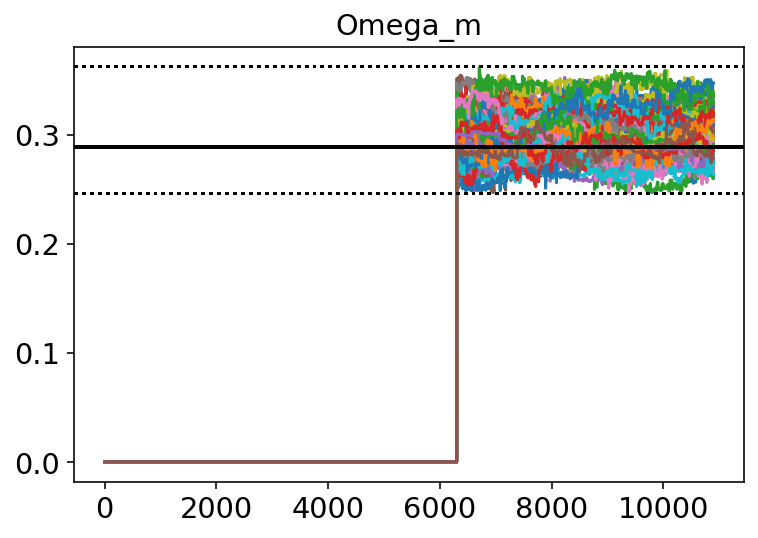

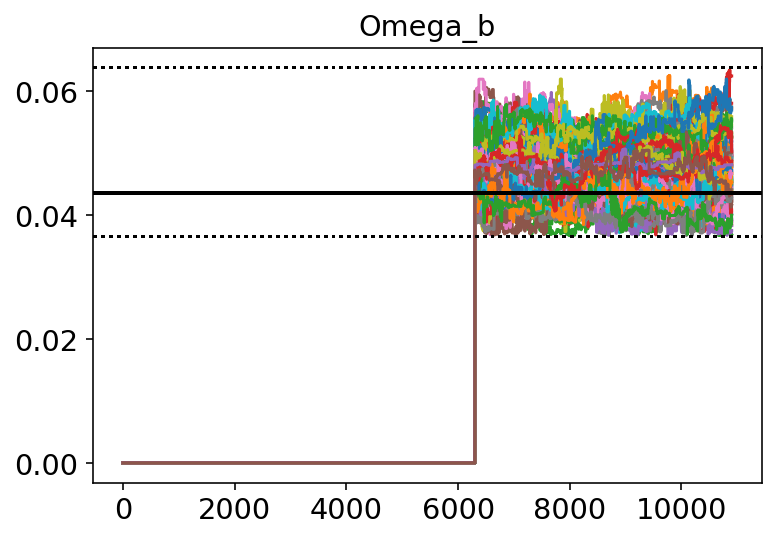

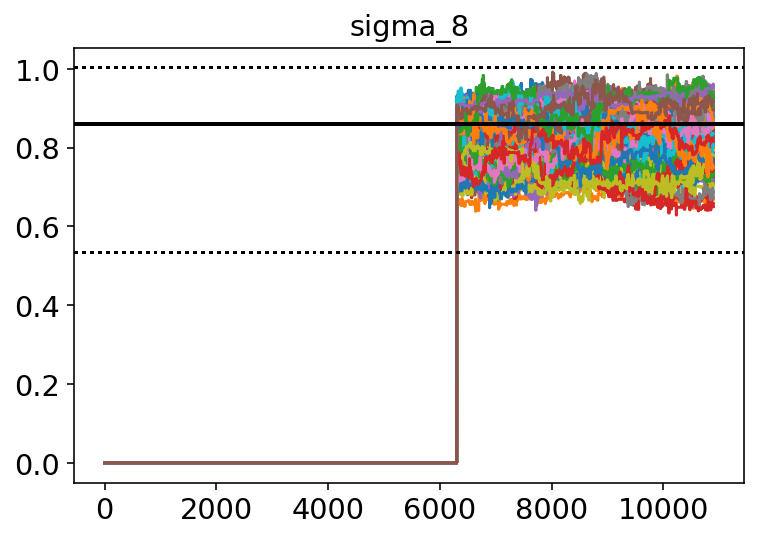

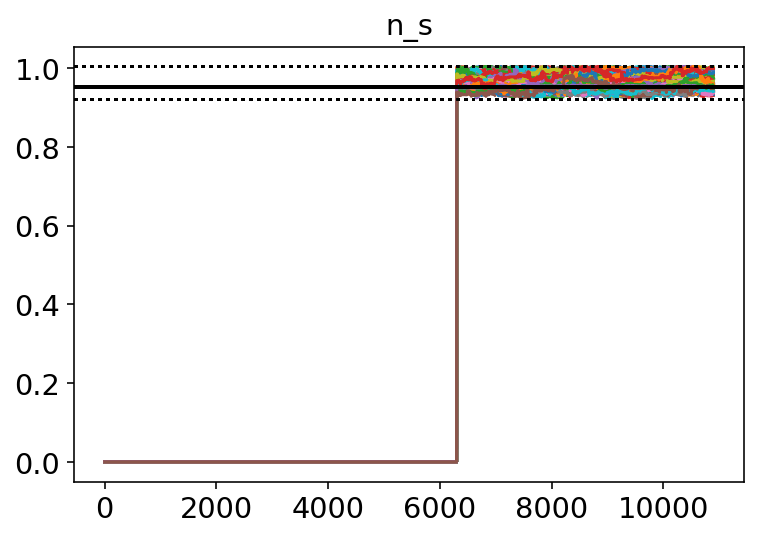

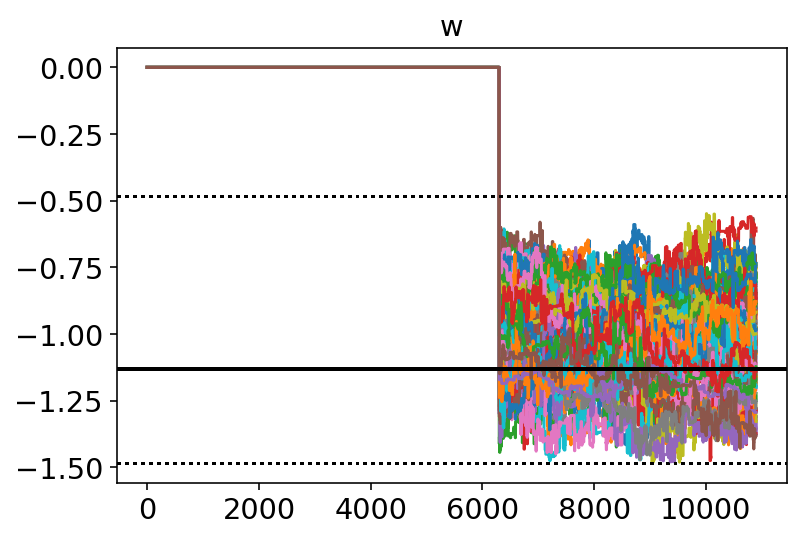

<Figure size 432x288 with 0 Axes>

In [18]:
plot_chains('wp_upf_c3h3_all_covperf', show_params=['Omega_m', 'Omega_b', 'sigma_8', 'n_s', 'w'], show_walkers=True, show_corner=False)

<HDF5 dataset "chain": shape (96, 500, 18), type "<f4">


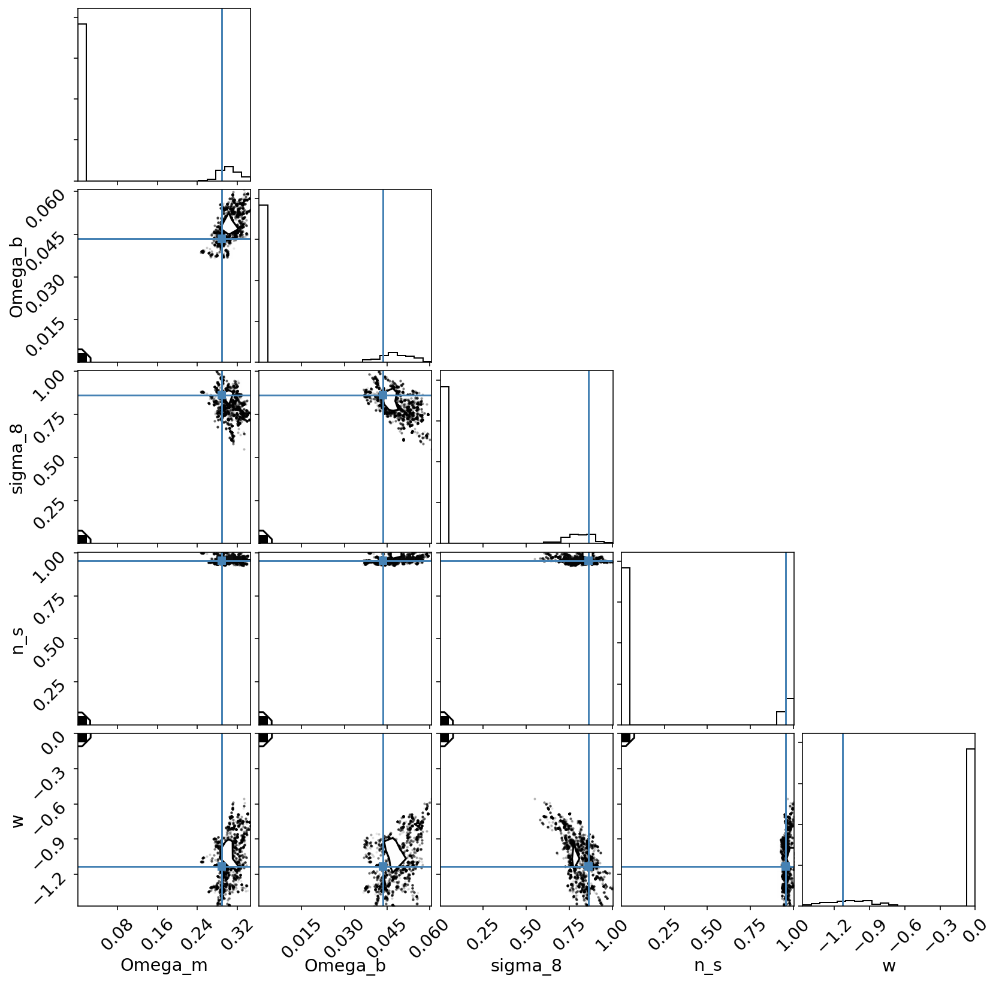

In [19]:
plot_chains('upf_c3h3_all_covperf', show_params=['Omega_m', 'Omega_b', 'sigma_8', 'n_s', 'w'])

<HDF5 dataset "chain": shape (96, 14800, 11), type "<f4">


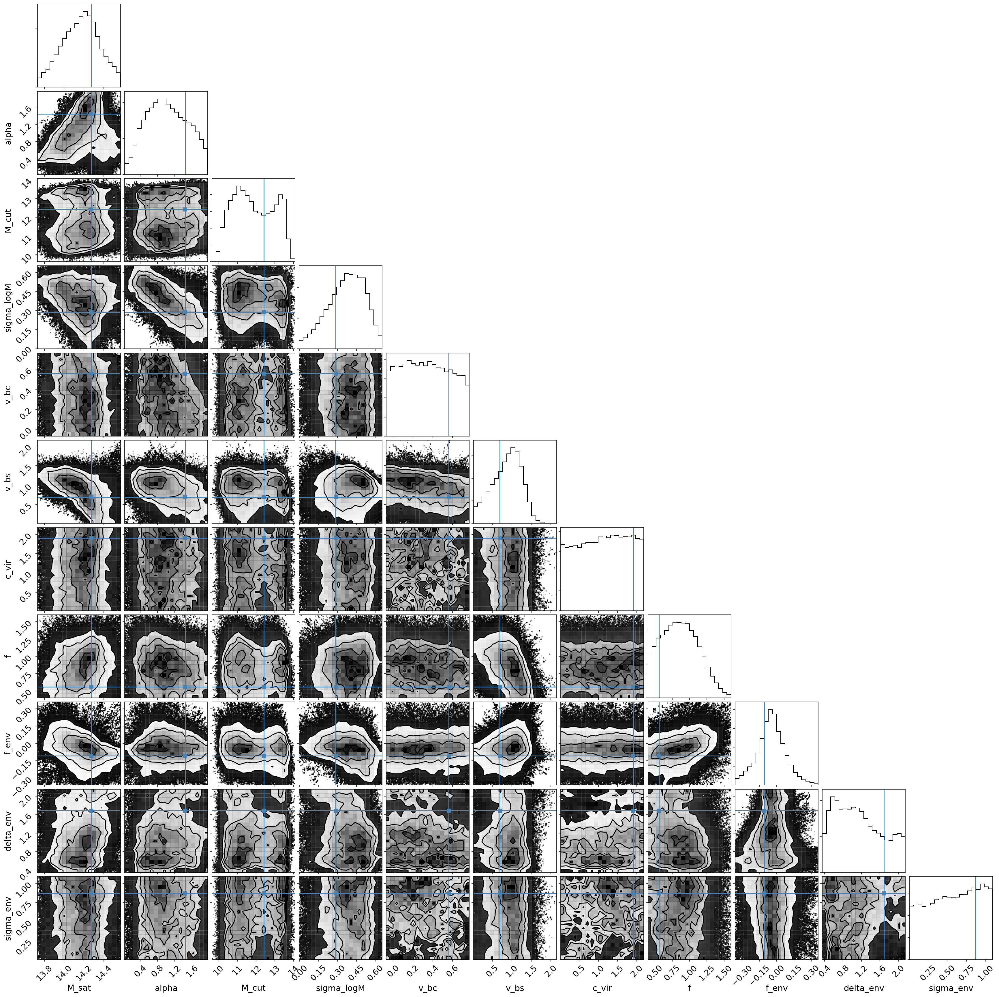

In [23]:
plot_chains('upf_c3h3_allhod_covperf')

<HDF5 dataset "chain": shape (96, 14900, 11), type "<f4">


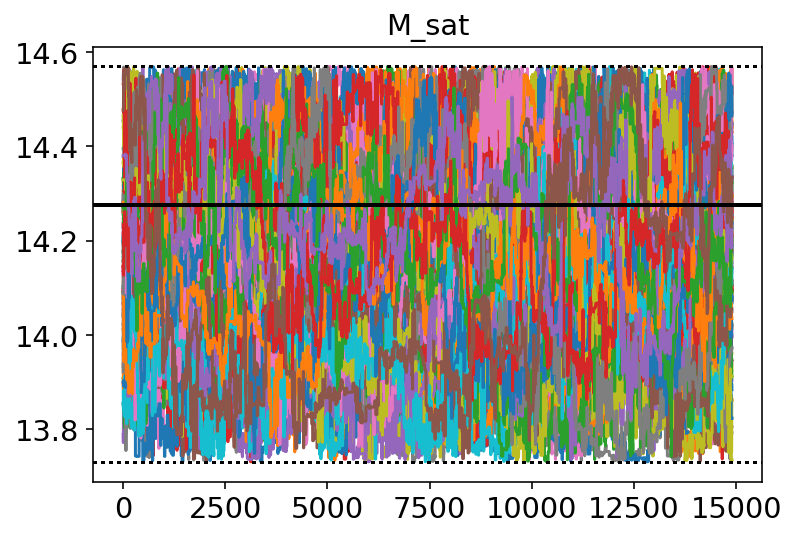

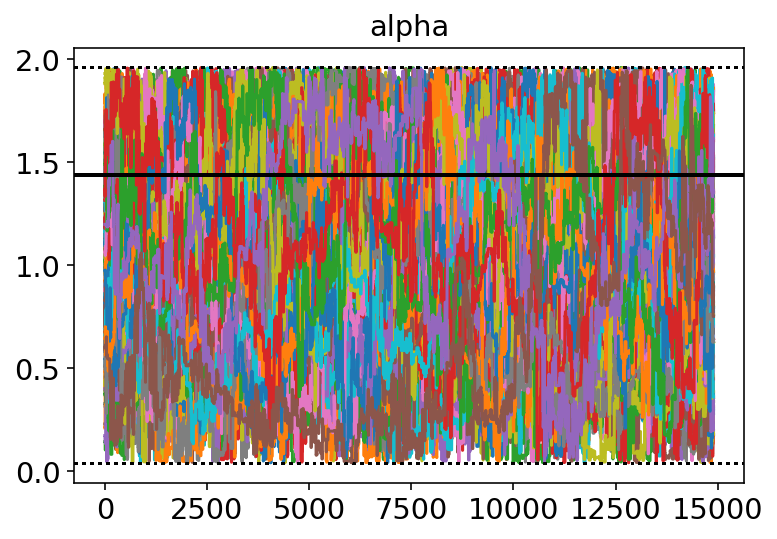

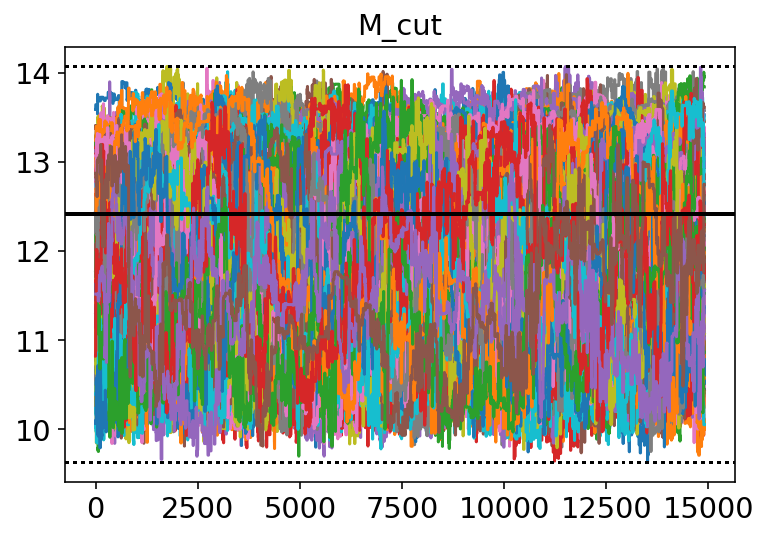

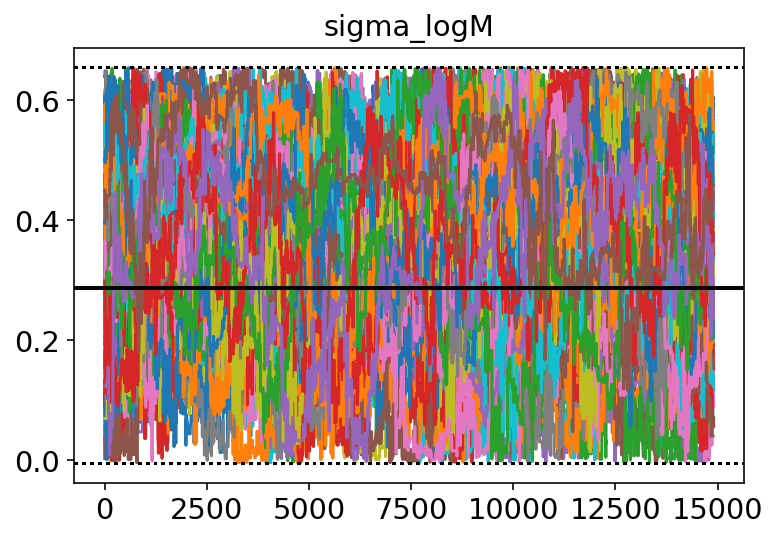

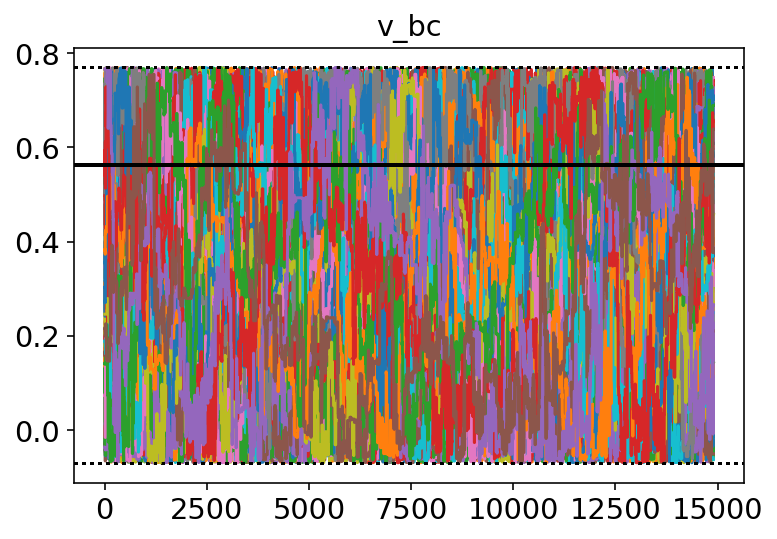

...

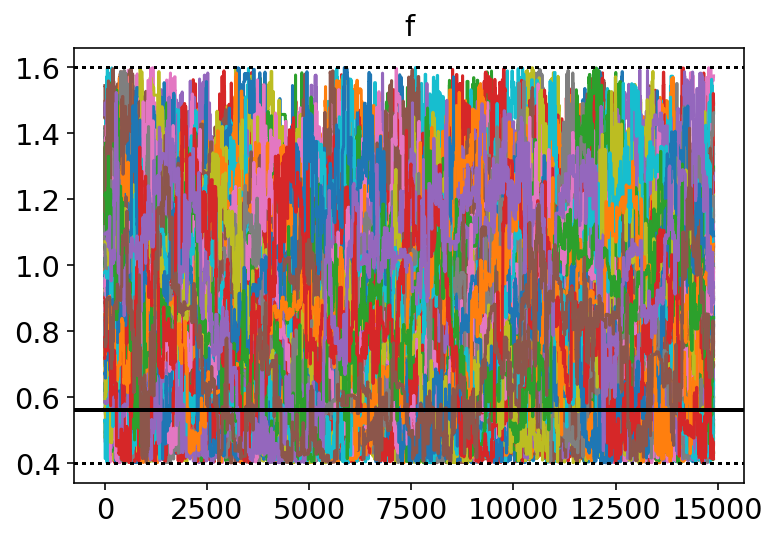

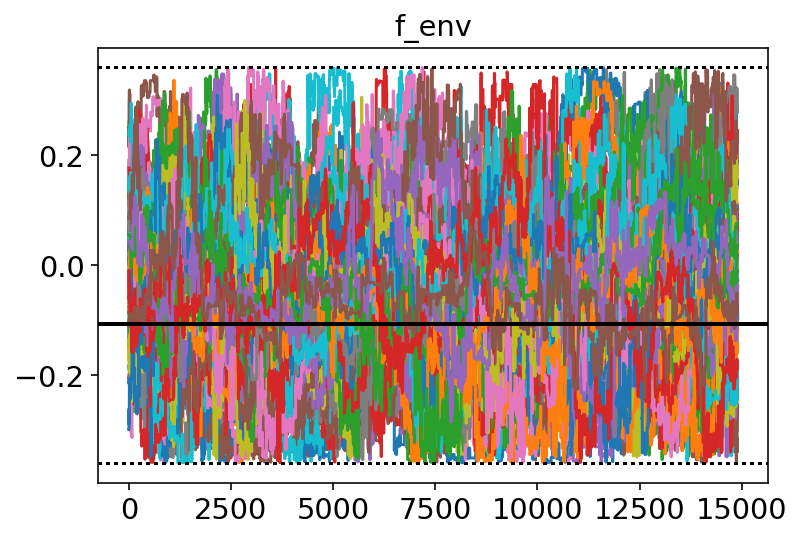

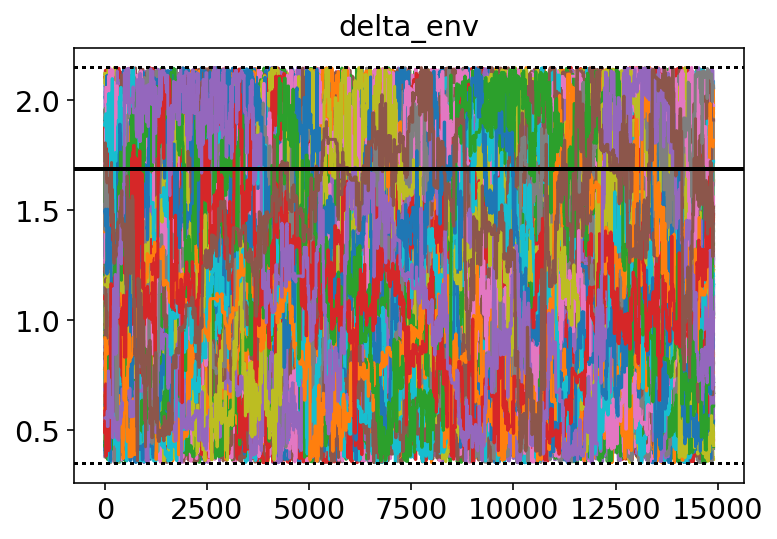

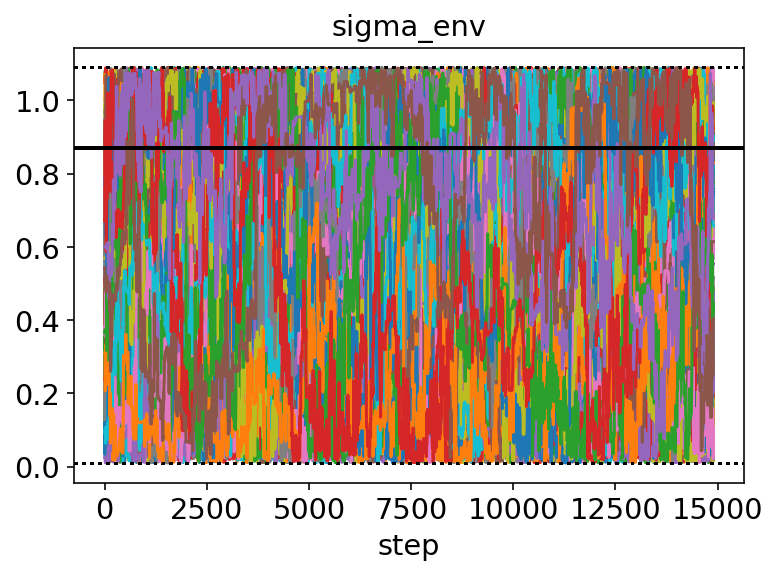

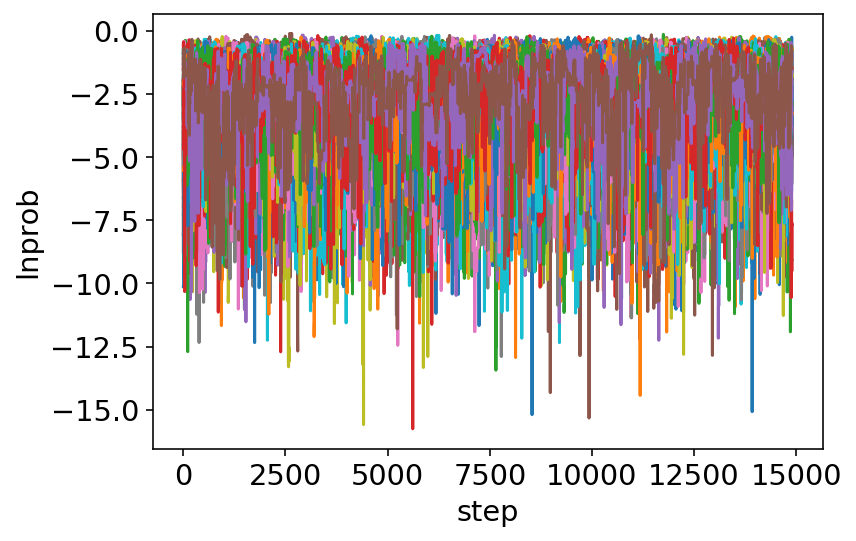

In [24]:
plot_chains('upf_c3h3_allhod_covperf', show_walkers=True, show_corner=False)

<HDF5 dataset "chain": shape (96, 7200, 7), type "<f4">


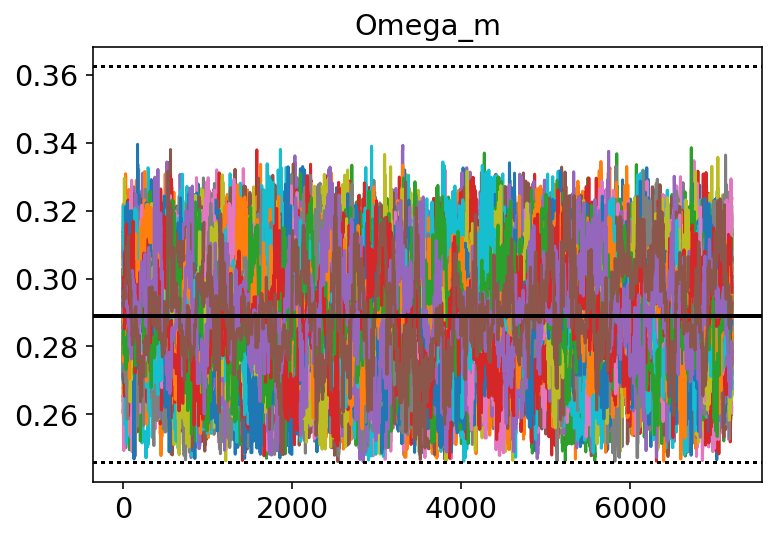

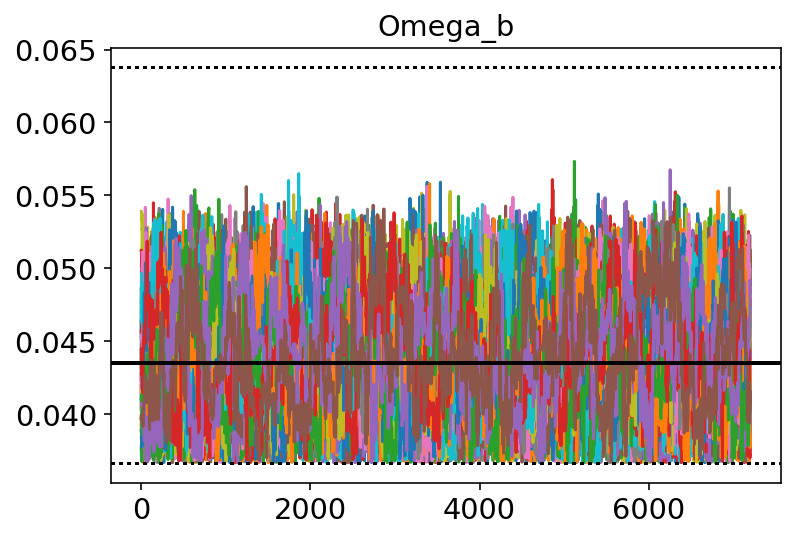

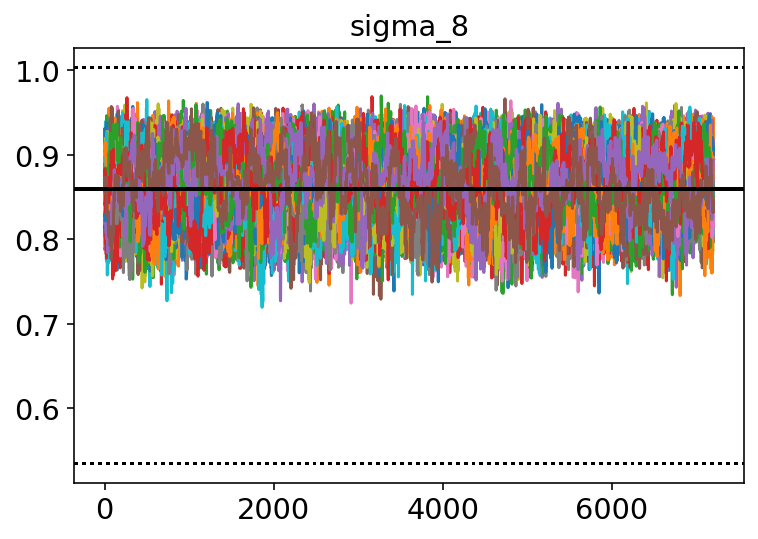

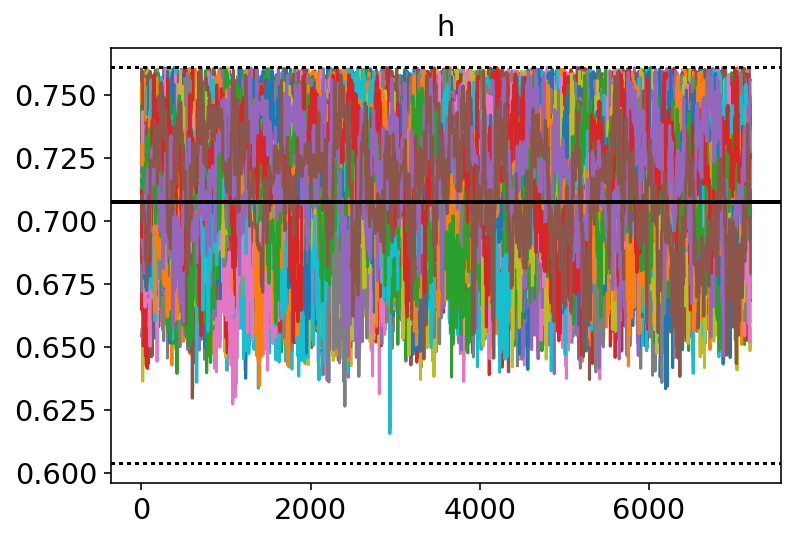

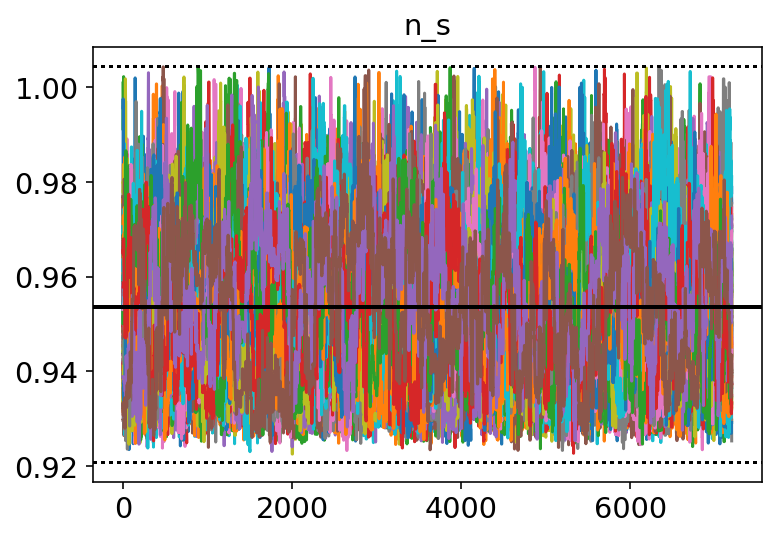

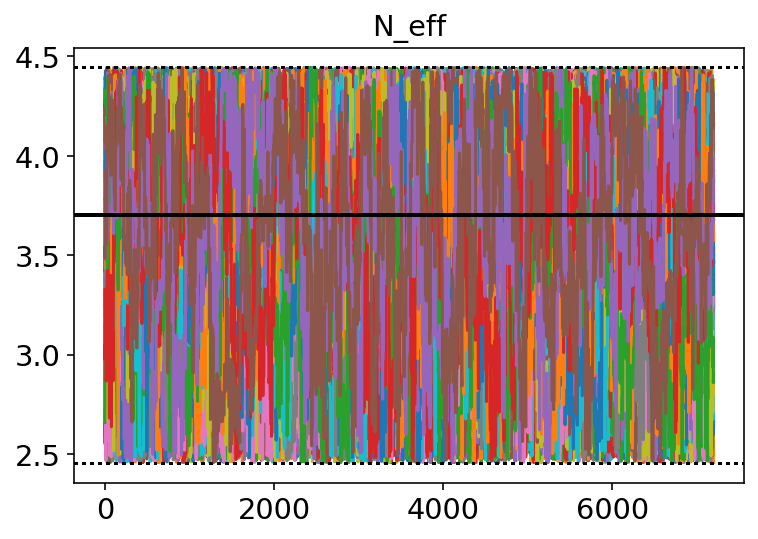

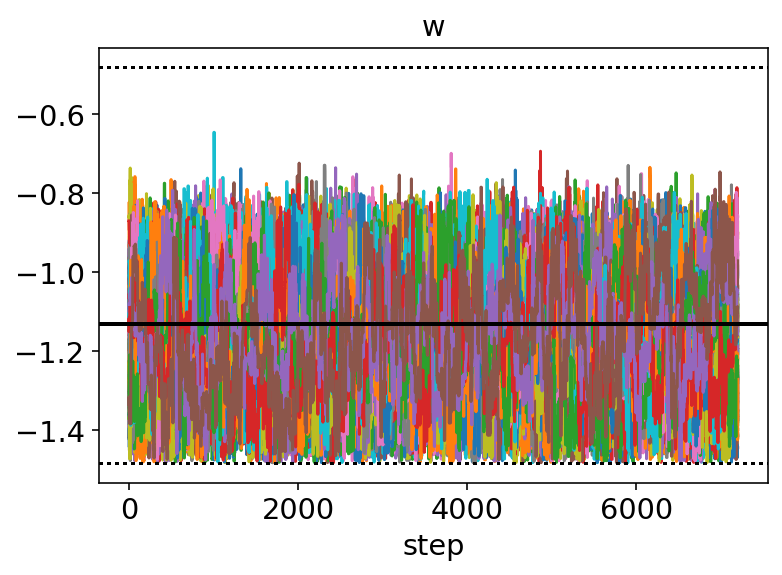

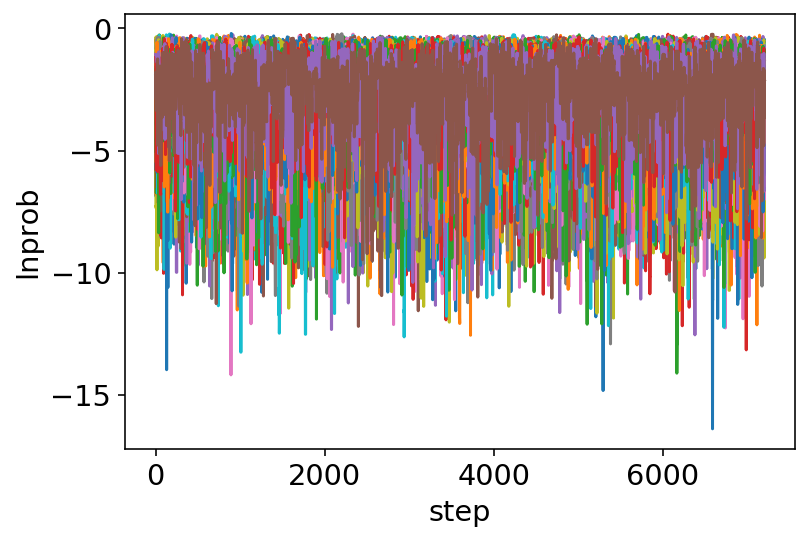

In [25]:
plot_chains('upf_c3h3_allcosmo_covperf', show_walkers=True, show_corner=False)

<HDF5 dataset "chain": shape (96, 1200, 18), type "<f4">


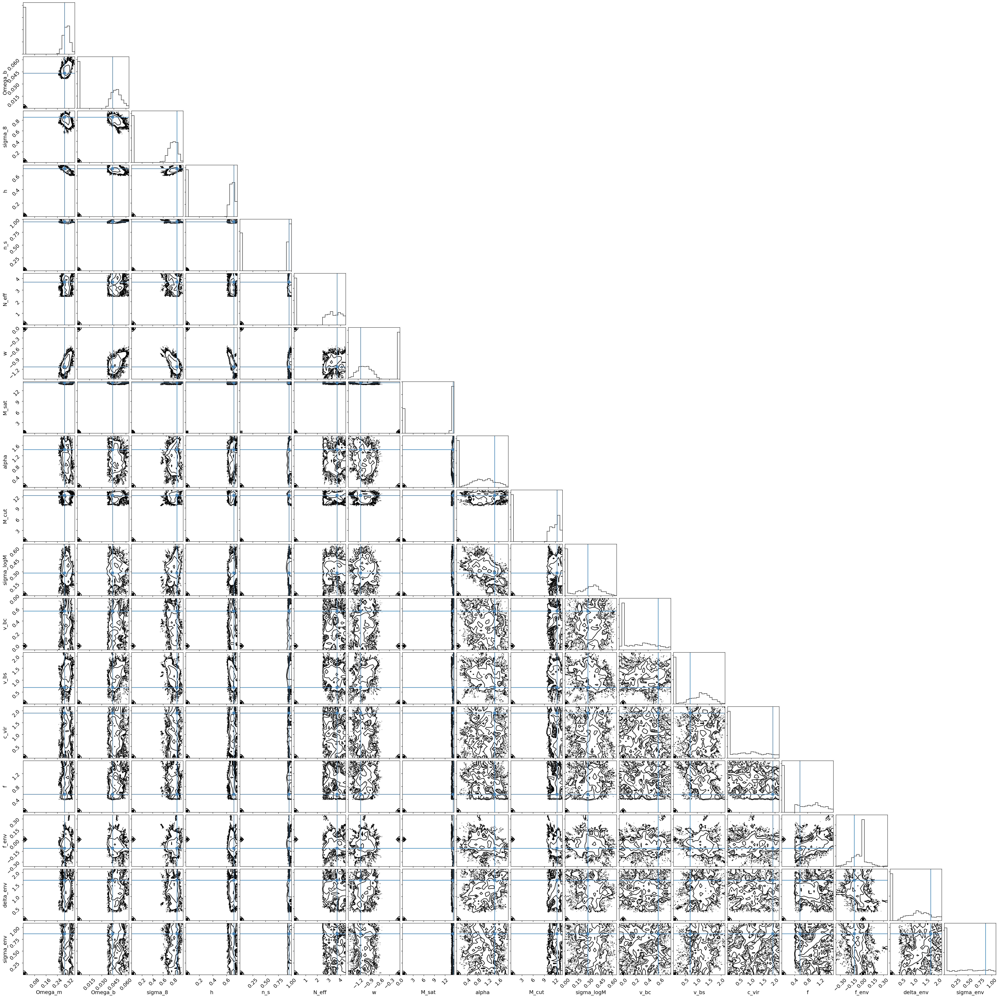

In [60]:
plot_chains('upf_c3h3_all_covperf')

In [37]:
print(check_chains('wp_upf_c3h3_all_covperf'))
print(check_chains('wp_upf_c3h3_allhod_covperf'))
print(check_chains('wp_upf_c3h3_allcosmo_covperf'))
print()
print(check_chains('upf_c3h3_all_covperf'))
print(check_chains('upf_c3h3_allhod_covperf'))
print(check_chains('upf_c3h3_allcosmo_covperf'))
print()
print(check_chains('wp_c3h3_all_covperf'))
print(check_chains('wp_c3h3_allhod_covperf'))
print(check_chains('wp_c3h3_allcosmo_covperf'))


wp_upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (0, 0, 18), type "<f4">
None
wp_upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
None
wp_upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 9300, 7), type "<f4">
None

upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (96, 11900, 18), type "<f4">
None
upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (96, 15100, 11), type "<f4">
None
upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 7300, 7), type "<f4">
None

chain ../chains/chains_wp_c3h3_all_covperf.h5 doesn't exist!
None
wp_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
None
chain ../chains/chains_wp_c3h3_allcosmo_covperf.h5 doesn't exist!
None


In [40]:
print(check_chains('wp_upf_c3h3_all_covperf'))
print(check_chains('wp_upf_c3h3_allhod_covperf'))
print(check_chains('wp_upf_c3h3_allcosmo_covperf'))
print()
print(check_chains('upf_c3h3_all_covperf'))
print(check_chains('upf_c3h3_allhod_covperf'))
print(check_chains('upf_c3h3_allcosmo_covperf'))
print()
print(check_chains('wp_c3h3_all_covperf'))
print(check_chains('wp_c3h3_allhod_covperf'))
print(check_chains('wp_c3h3_allcosmo_covperf'))



wp_upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (0, 0, 18), type "<f4">
None
wp_upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
None
wp_upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 9300, 7), type "<f4">
None

upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (96, 900, 18), type "<f4">
None
upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (96, 15200, 11), type "<f4">
None
upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 7400, 7), type "<f4">
None

chain ../chains/chains_wp_c3h3_all_covperf.h5 doesn't exist!
None
wp_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
None
chain ../chains/chains_wp_c3h3_allcosmo_covperf.h5 doesn't exist!
None


In [42]:
print(check_chains('wp_upf_c3h3_all_covperf'))
print(check_chains('wp_upf_c3h3_allhod_covperf'))
print(check_chains('wp_upf_c3h3_allcosmo_covperf'))
print()
print(check_chains('upf_c3h3_all_covperf'))
print(check_chains('upf_c3h3_allhod_covperf'))
print(check_chains('upf_c3h3_allcosmo_covperf'))
print()
print(check_chains('wp_c3h3_all_covperf'))
print(check_chains('wp_c3h3_allhod_covperf'))
print(check_chains('wp_c3h3_allcosmo_covperf'))

wp_upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (0, 0, 18), type "<f4">
None
wp_upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
None
wp_upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 9300, 7), type "<f4">
None

upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (96, 12000, 18), type "<f4">
None
upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (96, 15200, 11), type "<f4">
None
upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 7400, 7), type "<f4">
None

chain ../chains/chains_wp_c3h3_all_covperf.h5 doesn't exist!
None
wp_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
None
chain ../chains/chains_wp_c3h3_allcosmo_covperf.h5 doesn't exist!
None


In [56]:
check_chains('wp_upf_c3h3_all_covperf')
check_chains('wp_upf_c3h3_allhod_covperf')
check_chains('wp_upf_c3h3_allcosmo_covperf')
print()
check_chains('upf_c3h3_all_covperf')
check_chains('upf_c3h3_allhod_covperf')
check_chains('upf_c3h3_allcosmo_covperf')
print()
check_chains('wp_c3h3_all_covperf')
check_chains('wp_c3h3_allhod_covperf')
check_chains('wp_c3h3_allcosmo_covperf')

wp_upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (0, 0, 18), type "<f4">
wp_upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
wp_upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 9300, 7), type "<f4">

upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (96, 1000, 18), type "<f4">
upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (96, 15200, 11), type "<f4">
upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 7400, 7), type "<f4">

chain ../chains/chains_wp_c3h3_all_covperf.h5 doesn't exist!
wp_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
chain ../chains/chains_wp_c3h3_allcosmo_covperf.h5 doesn't exist!


In [64]:
check_chains('wp_upf_c3h3_all_covperf')
check_chains('wp_upf_c3h3_allhod_covperf')
check_chains('wp_upf_c3h3_allcosmo_covperf')
print()
check_chains('upf_c3h3_all_covperf')
check_chains('upf_c3h3_allhod_covperf')
check_chains('upf_c3h3_allcosmo_covperf')
print()
check_chains('wp_c3h3_all_covperf')
check_chains('wp_c3h3_allhod_covperf')
check_chains('wp_c3h3_allcosmo_covperf')

wp_upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (0, 0, 18), type "<f4">
wp_upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (0, 0, 11), type "<f4">
wp_upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (0, 0, 7), type "<f4">

upf_c3h3_all_covperf: <HDF5 dataset "chain": shape (96, 1200, 18), type "<f4">
upf_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (96, 15500, 11), type "<f4">
upf_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (96, 7500, 7), type "<f4">

wp_c3h3_all_covperf: <HDF5 dataset "chain": shape (0, 0, 18), type "<f4">
wp_c3h3_allhod_covperf: <HDF5 dataset "chain": shape (96, 100, 11), type "<f4">
wp_c3h3_allcosmo_covperf: <HDF5 dataset "chain": shape (0, 0, 7), type "<f4">
